In [1]:
"""
    Experimentation with neural networks on a datset of MRI covid/non-covid images.
    
    Created:9/21 (Akarsh V Hebbar)
    
    
    
    Potential source of getting all layer predictions: https://stackoverflow.com/questions/51677631/keras-tensorflow-get-predictions-or-output-of-all-layers-efficiently

"""

import cv2, random
import numpy as np
import matplotlib.pyplot as plt
import keract

import tensorflow as tf
from tensorflow.keras.layers import *
from keract import get_activations, display_heatmaps, display_activations
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras import activations

from DataHandler import dataHandler


In [2]:
dh = dataHandler() # data handler object. See DataHandler.py for more information.

# ALTER HYPERPARAMETERS HERE
BATCH_SIZE = 64

In [3]:
dataset = dh.get_all_data_labeled(shuffle=True)

In [4]:
# check that all data is in place
assert len(dh.get_non_covid_data_fp()) == 397 and len(dh.get_covid_data_fp()) == 326 and len(dh.get_all_data_labeled()) == (397 + 326)

In [5]:
datapoint = dataset[0] # get some datapoint from the dataset
random_img = cv2.imread(datapoint[0])

Label:  1.0
filepath:  C:\Users\Akarsh\CSCI-8860\data\CT_COVID\2020.03.30.20047985-p9-56%3.png
image dimensions:  (285, 442, 3)
image datatype:  uint8
image max:  255
image min


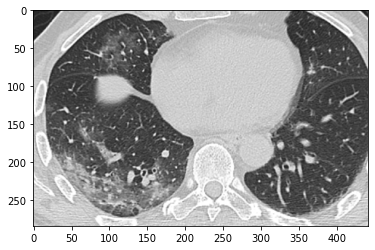

In [6]:
print("Label: ", datapoint[1])
print("filepath: ", datapoint[0])
print("image dimensions: ", random_img.shape)
print("image datatype: ", random_img.dtype)
print("image max: ", random_img.max())
print("image min")
plt.imshow(random_img)

In [7]:
# split the dataset into a train and test dataset

split_point = int(len(dataset) * .8 ) # 80 / 20 split

train_data = dataset[0:split_point]
test_data = dataset[split_point:]

assert len(train_data) + len(test_data) == (397 + 326) # ensure all expected data is present

train_data = train_data + train_data + train_data + train_data + train_data # when using the noise adder and random rotation then triple the datasets
random.shuffle(train_data)

In [8]:
# get the image data and load it into memory


train_X = np.asarray([dh.load_image(fp, resize=True, add_noise=False, randomly_rotate=False, grayscale=True) for (fp, label) in train_data]).astype('uint8')
train_y = np.asarray([label for (fp, label) in train_data]).astype('float16')

test_X = np.asarray([dh.load_image(fp, resize=True, add_noise=False, randomly_rotate=False, grayscale=True) for (fp, label) in test_data]).astype('uint8')
test_y = np.asarray([np.asarray(label) for (fp, label) in test_data]).astype('float16')

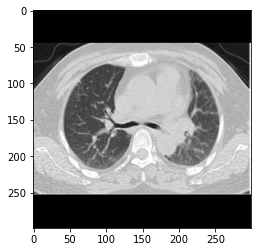

In [9]:
plt.imshow(train_X[0], cmap='gray')

In [10]:
vgg_model = tf.keras.applications.vgg16.VGG16(weights='imagenet',include_top=False)
vgg_model.trainable = False
x = vgg_model.output
x = Dropout(0.2)(x)
x = Dense(32, activation='relu', dtype=tf.float32)(x)
x = Dropout(0.5)(x)
x = GlobalAveragePooling2D()(x)
x = Dense(16, activation='relu', dtype=tf.float32)(x)
x = Dropout(0.5)(x)
#x = GlobalAveragePooling2D()(x)
#x = Dropout(0.5)(x)
prediction = Dense(1, activation='sigmoid', dtype=tf.float32)(x)


complete_model = tf.keras.Model(inputs=vgg_model.input,outputs=prediction)

visualization_model = tf.keras.Model(inputs=vgg_model.input, 
                                    outputs=[l.output for l in complete_model.layers[1:] if 'conv' in l.name])



complete_model.compile(optimizer='adam', loss=tf.keras.losses.BinaryCrossentropy(), metrics=tf.keras.metrics.BinaryAccuracy(),)

# just the very last layer should be trainable for now
complete_model.layers[len(complete_model.layers)-1].trainable = True




In [11]:
complete_model.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)  

In [12]:
visualization_model.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)  

In [13]:
complete_model.fit(x=train_X, y=train_y, batch_size=BATCH_SIZE, validation_data=(test_X, test_y), epochs=100, )

Epoch 1/100
46/46 [==============================] - 479s 10s/step - loss: 1.1620 - binary_accuracy: 0.5702 - val_loss: 0.6330 - val_binary_accuracy: 0.6483
Epoch 2/100
46/46 [==============================] - 477s 10s/step - loss: 0.5949 - binary_accuracy: 0.6626 - val_loss: 0.5768 - val_binary_accuracy: 0.6966
Epoch 3/100
46/46 [==============================] - 478s 10s/step - loss: 0.5416 - binary_accuracy: 0.7083 - val_loss: 0.5269 - val_binary_accuracy: 0.7034
Epoch 4/100
46/46 [==============================] - 478s 10s/step - loss: 0.4987 - binary_accuracy: 0.7384 - val_loss: 0.4912 - val_binary_accuracy: 0.7793
Epoch 5/100
46/46 [==============================] - 481s 10s/step - loss: 0.4596 - binary_accuracy: 0.7765 - val_loss: 0.4614 - val_binary_accuracy: 0.8000
Epoch 6/100
46/46 [==============================] - 478s 10s/step - loss: 0.4163 - binary_accuracy: 0.7882 - val_loss: 0.4446 - val_binary_accuracy: 0.8069
Epoch 7/100
46/46 [==============================] - 486s 

Epoch 53/100
46/46 [==============================] - 558s 12s/step - loss: 0.0180 - binary_accuracy: 0.9907 - val_loss: 0.6491 - val_binary_accuracy: 0.8897
Epoch 54/100
46/46 [==============================] - 527s 11s/step - loss: 0.0256 - binary_accuracy: 0.9893 - val_loss: 0.7061 - val_binary_accuracy: 0.8759
Epoch 55/100
46/46 [==============================] - 532s 12s/step - loss: 0.0256 - binary_accuracy: 0.9855 - val_loss: 0.6613 - val_binary_accuracy: 0.8828
Epoch 56/100
46/46 [==============================] - 554s 12s/step - loss: 0.0160 - binary_accuracy: 0.9920 - val_loss: 0.7214 - val_binary_accuracy: 0.8828
Epoch 57/100
46/46 [==============================] - 558s 12s/step - loss: 0.0189 - binary_accuracy: 0.9931 - val_loss: 0.6891 - val_binary_accuracy: 0.8759
Epoch 58/100
46/46 [==============================] - 556s 12s/step - loss: 0.0159 - binary_accuracy: 0.9962 - val_loss: 0.6541 - val_binary_accuracy: 0.8966
Epoch 59/100
46/46 [==============================] 

In [14]:
# now fine tune the model itself
vgg_model.trainable = True
history = complete_model.fit(x=train_X, y=train_y, batch_size=BATCH_SIZE, validation_data=(test_X, test_y), epochs=50)

Epoch 1/50
46/46 [==============================] - 479s 10s/step - loss: 0.0151 - binary_accuracy: 0.9952 - val_loss: 0.6856 - val_binary_accuracy: 0.8966
Epoch 2/50
46/46 [==============================] - 479s 10s/step - loss: 0.0102 - binary_accuracy: 0.9976 - val_loss: 0.7766 - val_binary_accuracy: 0.8966
Epoch 3/50
46/46 [==============================] - 479s 10s/step - loss: 0.0109 - binary_accuracy: 0.9983 - val_loss: 0.7229 - val_binary_accuracy: 0.8897
Epoch 4/50
46/46 [==============================] - 480s 10s/step - loss: 0.0265 - binary_accuracy: 0.9927 - val_loss: 0.5872 - val_binary_accuracy: 0.8897
Epoch 5/50
46/46 [==============================] - 478s 10s/step - loss: 0.0113 - binary_accuracy: 0.9958 - val_loss: 0.6926 - val_binary_accuracy: 0.8897
Epoch 6/50
46/46 [==============================] - 479s 10s/step - loss: 0.0149 - binary_accuracy: 0.9948 - val_loss: 0.6855 - val_binary_accuracy: 0.8966
Epoch 7/50
46/46 [==============================] - 478s 10s/ste

In [15]:
conv_lays = []

count = 0
    
for lay in complete_model.layers:
    if 'conv' in lay.name:
        conv_layer = lay
        conv_lays.append(lay)
        
print("Number of convolution layers: ", len(conv_lays))

Number of convolution layers:  13


In [16]:
datapoint = test_data[len(test_data)-1]

img_data = np.asarray([dh.load_image(datapoint[0], resize=True)]).astype('uint8')

print("datapoint label: ", datapoint[1])
print("model prediction: ", complete_model.predict(img_data))

all_layer_outputs = visualization_model.predict(img_data)

datapoint label:  0.0
model prediction:  [[7.0178903e-09]]


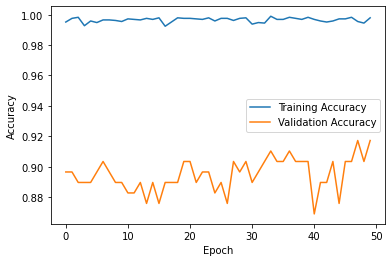

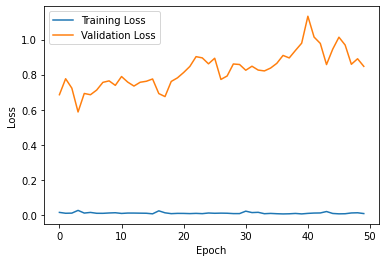

In [17]:
plt.plot(history.history['binary_accuracy'])
plt.plot(history.history['val_binary_accuracy'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Training Accuracy','Validation Accuracy'])
plt.savefig('finetuned_acc_epoch_v1(vgg1).png', transparent= True, bbox_inches= 'tight', dpi= 900)
plt.show()

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Training Loss','Validation Loss'])
plt.savefig('finetuned_loss_epoch_v1(vgg1).png', transparent= True, bbox_inches= 'tight', dpi= 900)
plt.show()


input_1 (1, 299, 299, 3) 


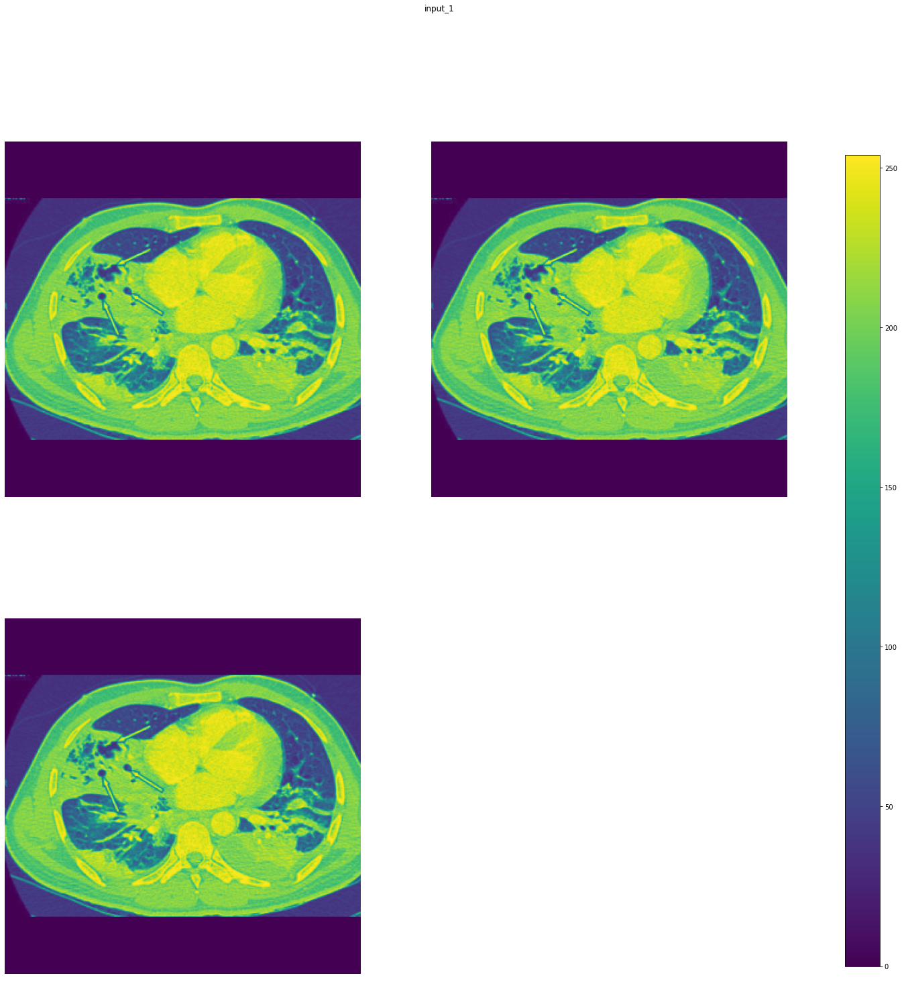

block1_conv1 (1, 299, 299, 64) 


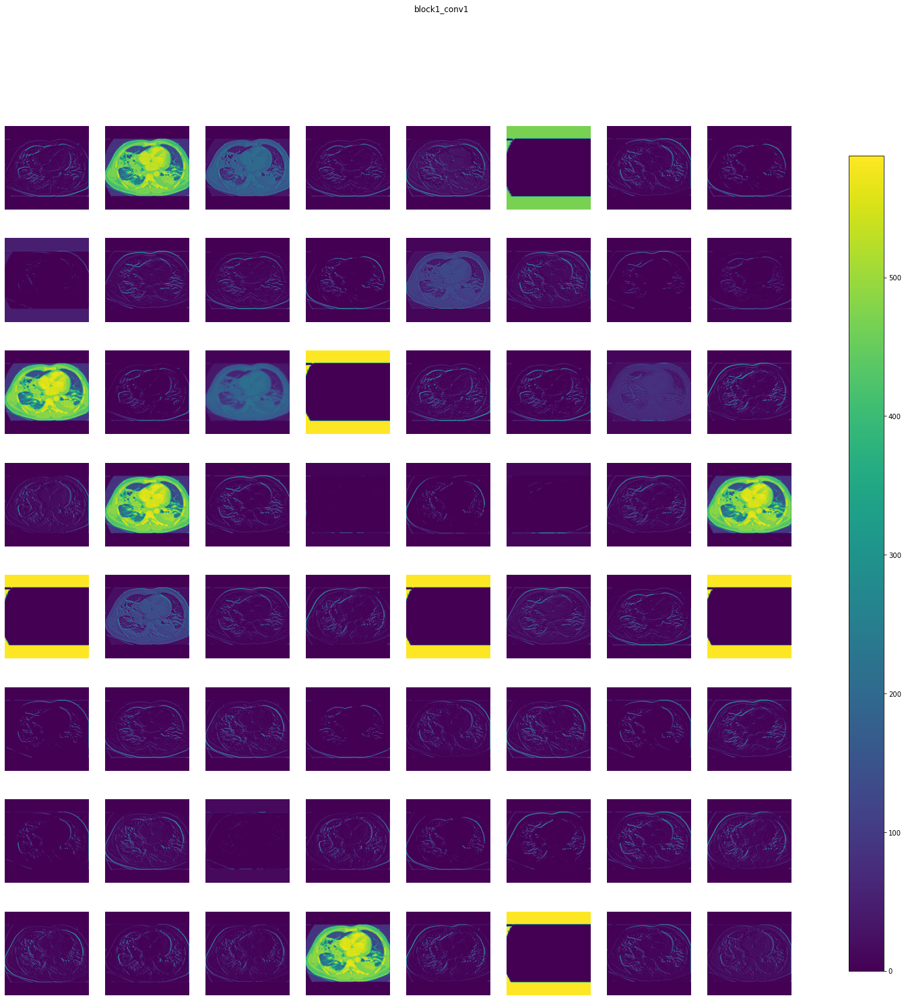

block1_conv2 (1, 299, 299, 64) 


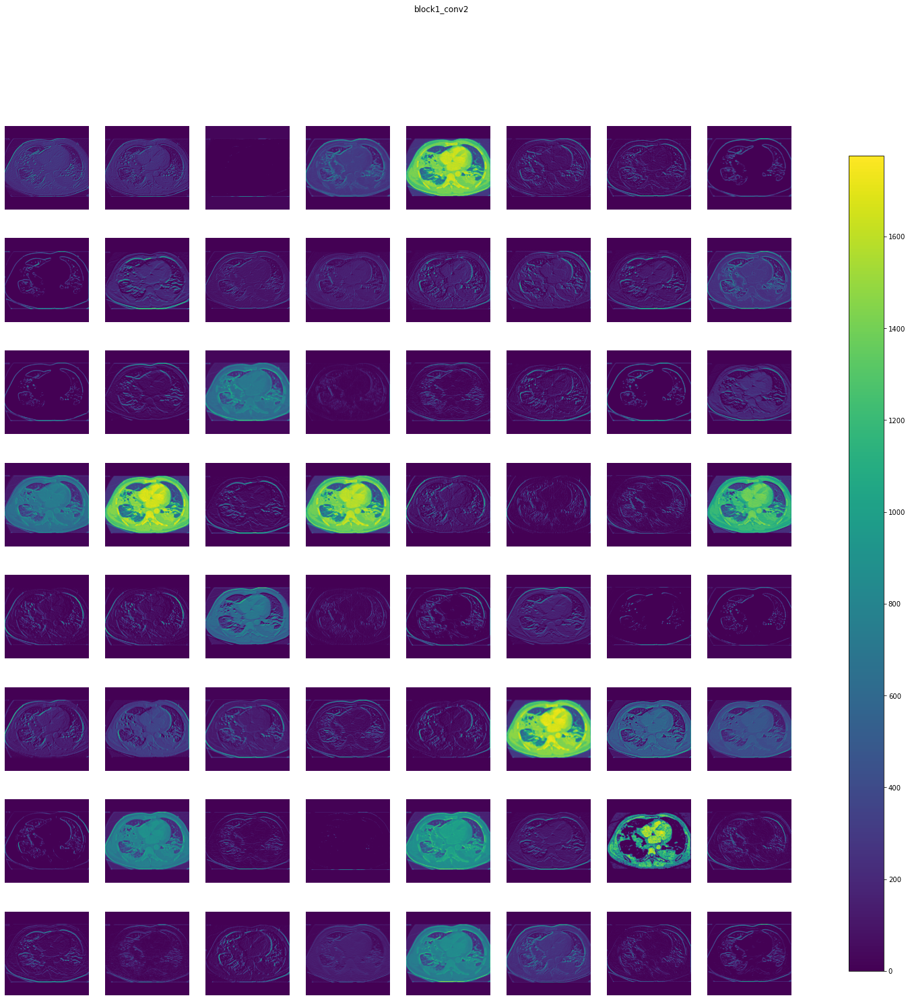

block1_pool (1, 149, 149, 64) 


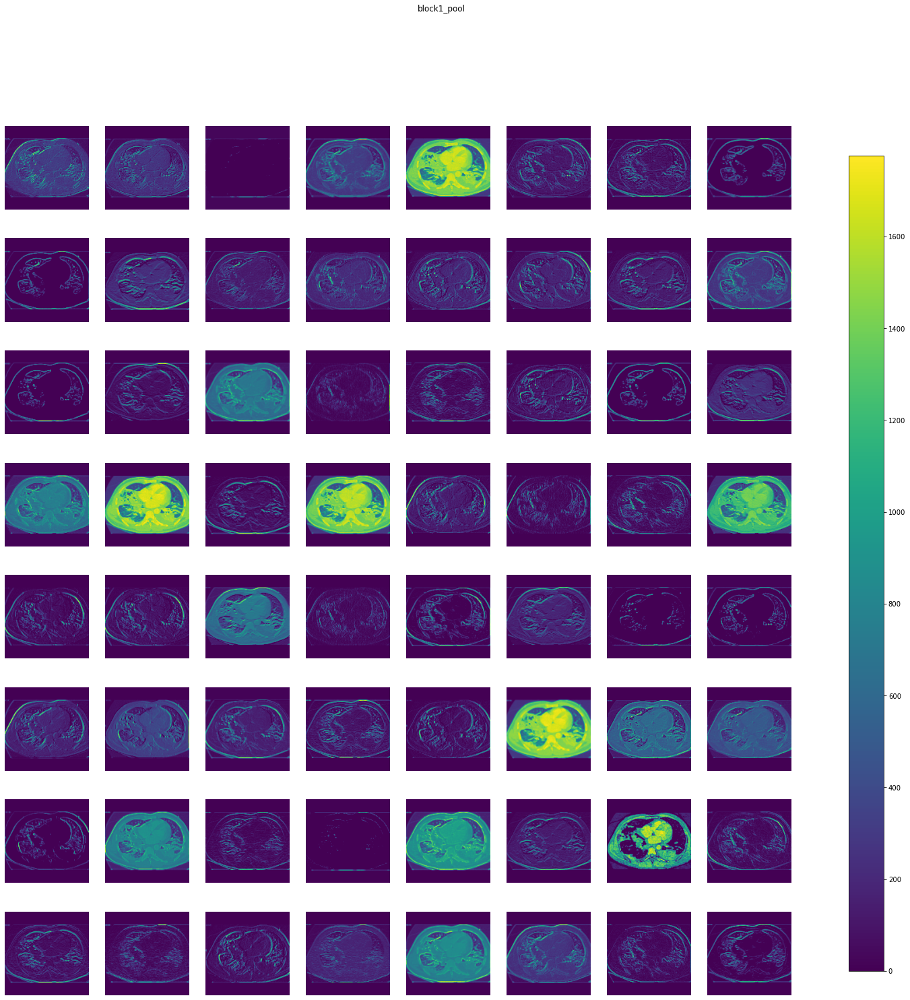

block2_conv1 (1, 149, 149, 128) 


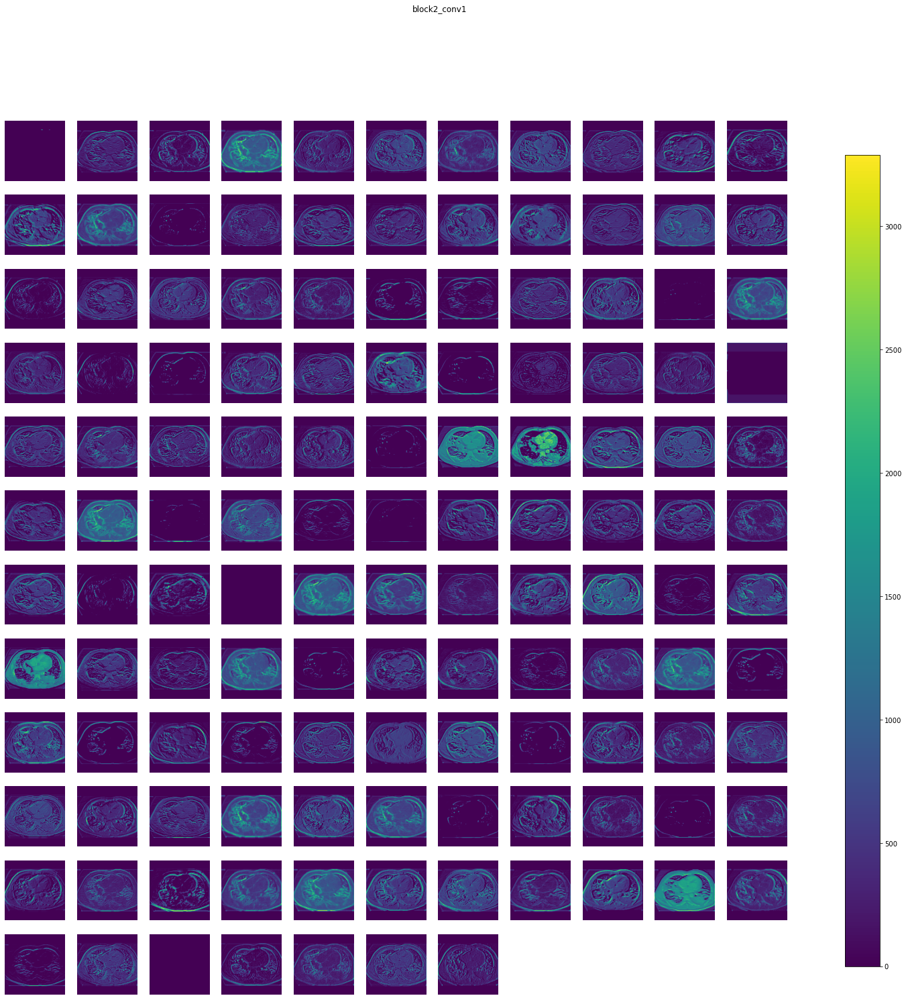

block2_conv2 (1, 149, 149, 128) 


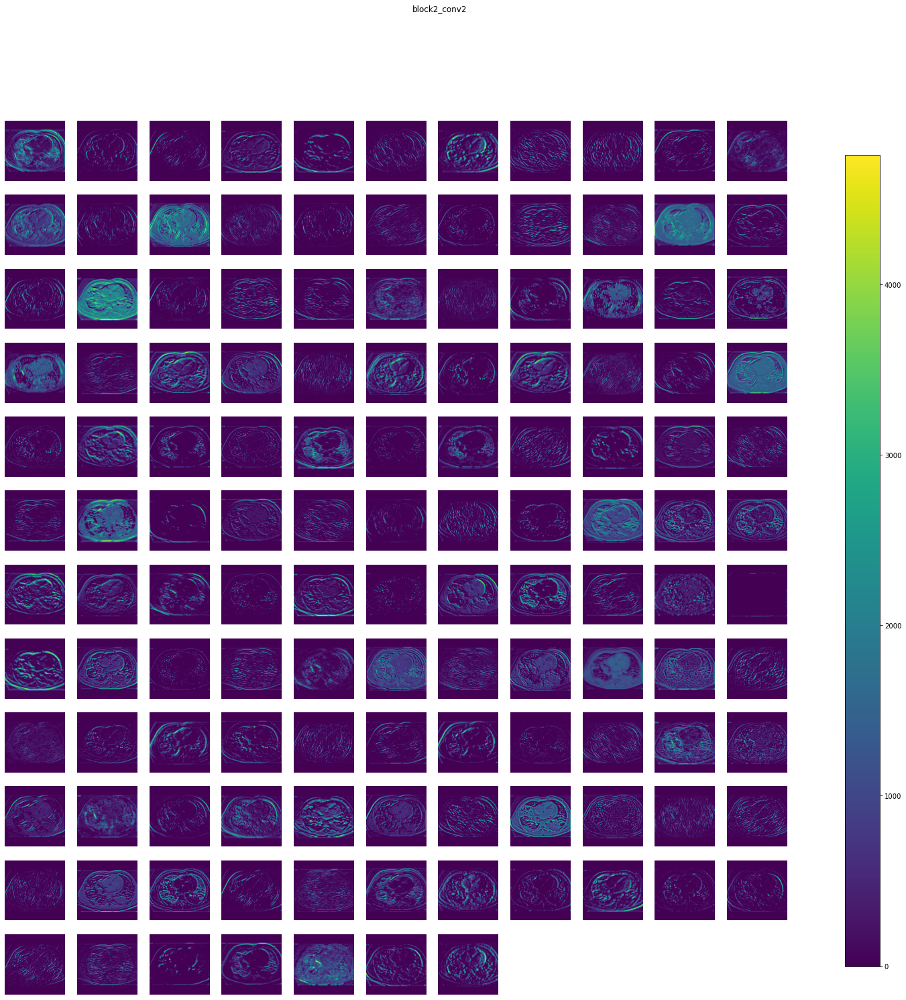

block2_pool (1, 74, 74, 128) 


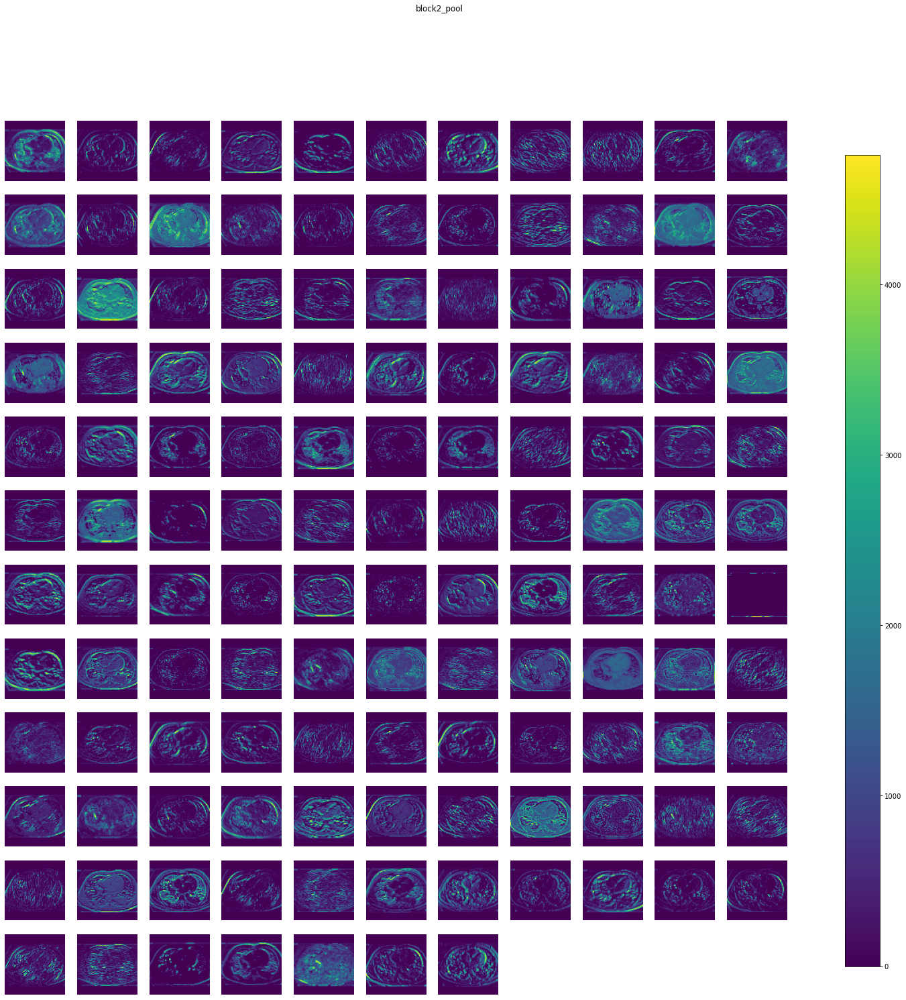

block3_conv1 (1, 74, 74, 256) 


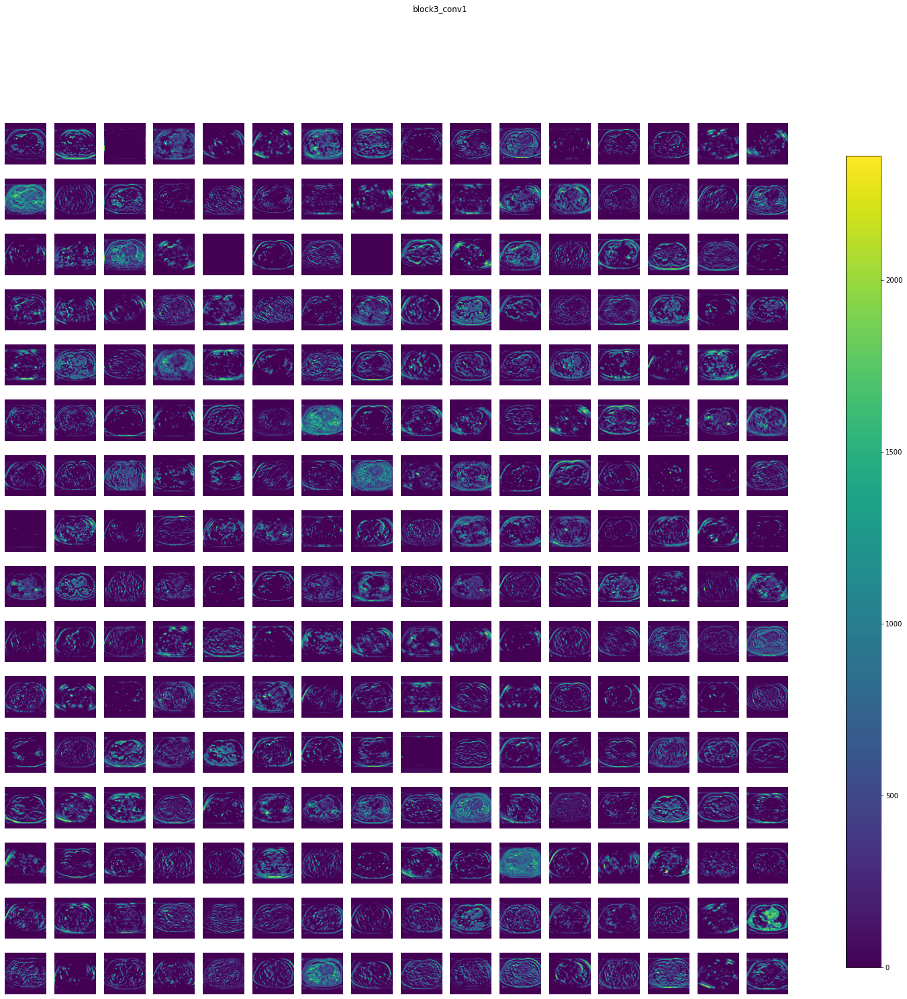

block3_conv2 (1, 74, 74, 256) 


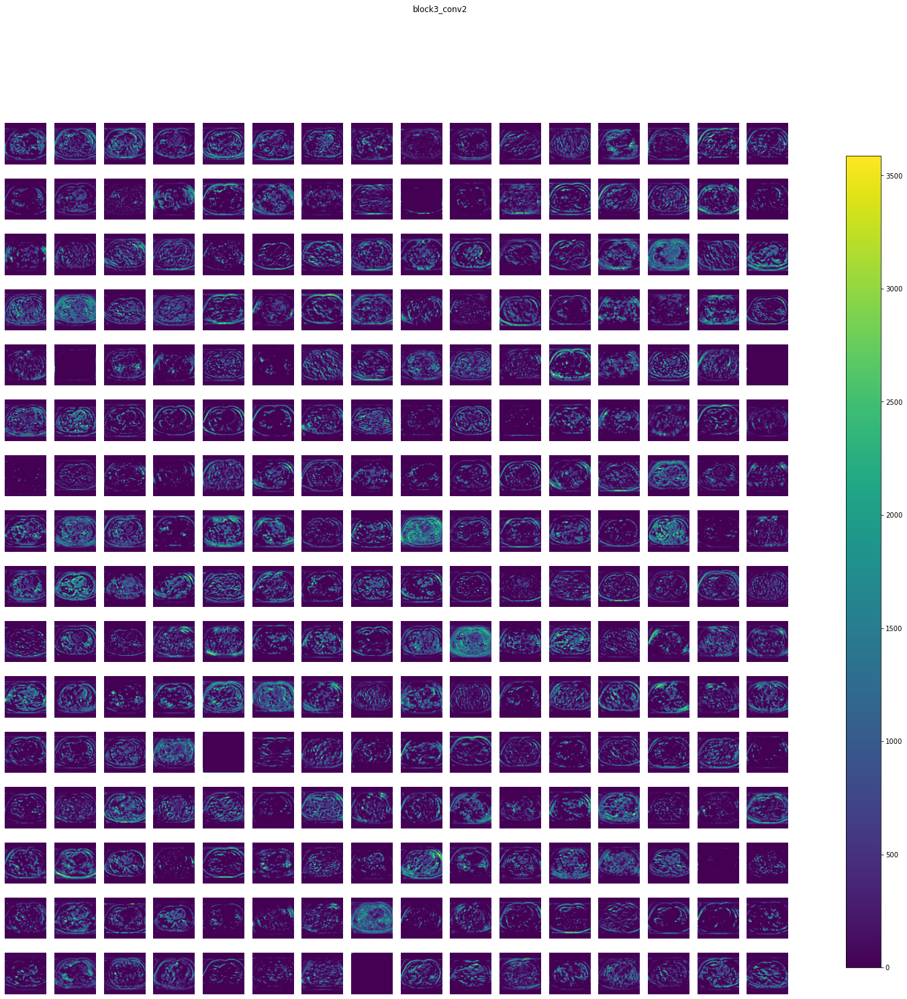

block3_conv3 (1, 74, 74, 256) 


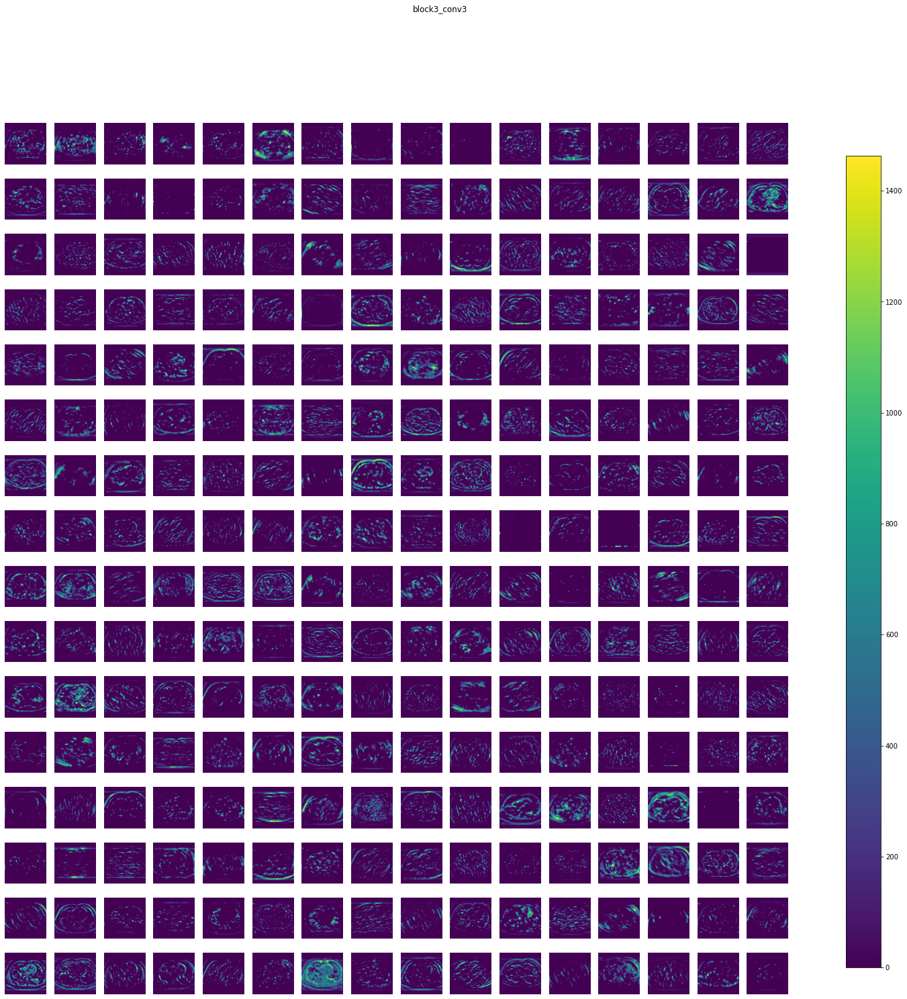

block3_pool (1, 37, 37, 256) 


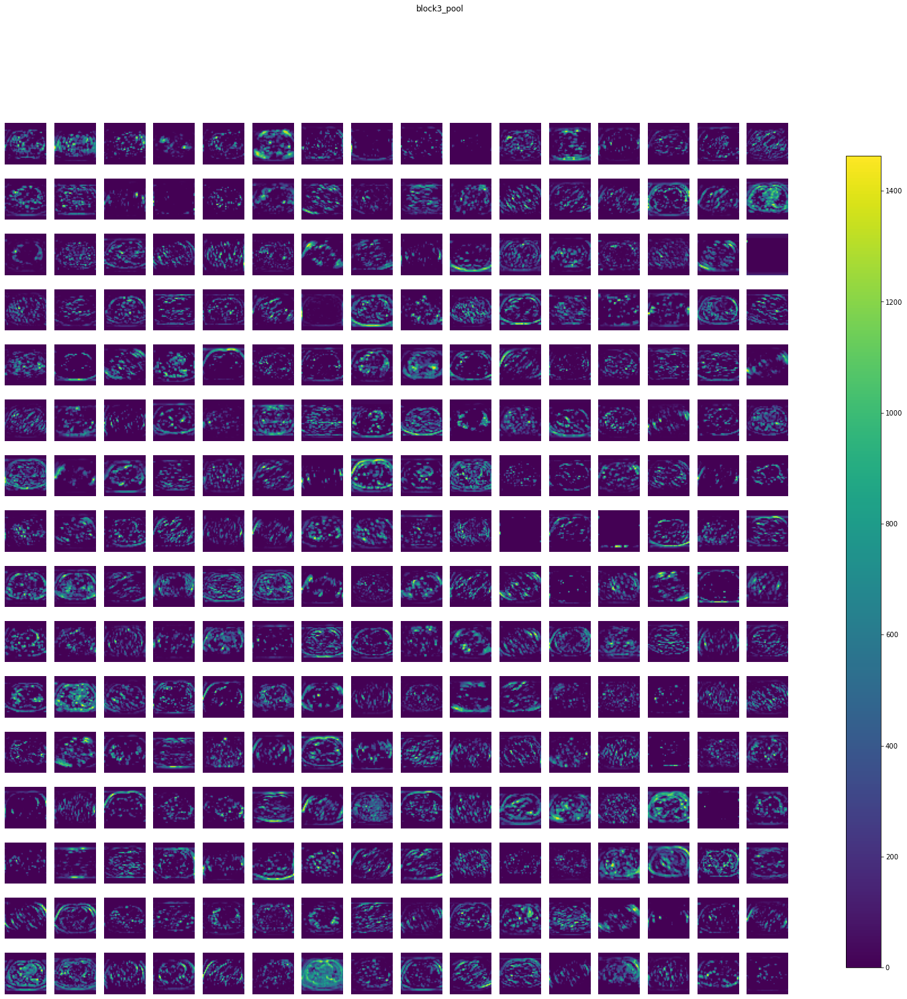

block4_conv1 (1, 37, 37, 512) 


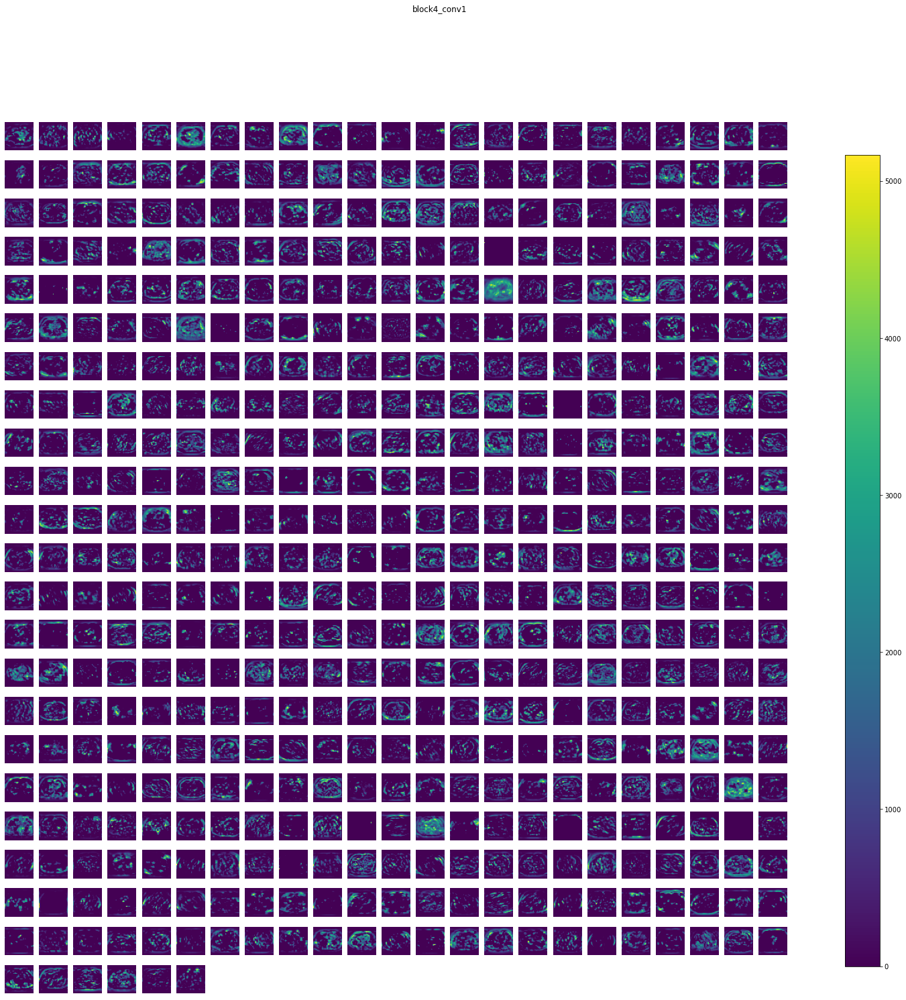

block4_conv2 (1, 37, 37, 512) 


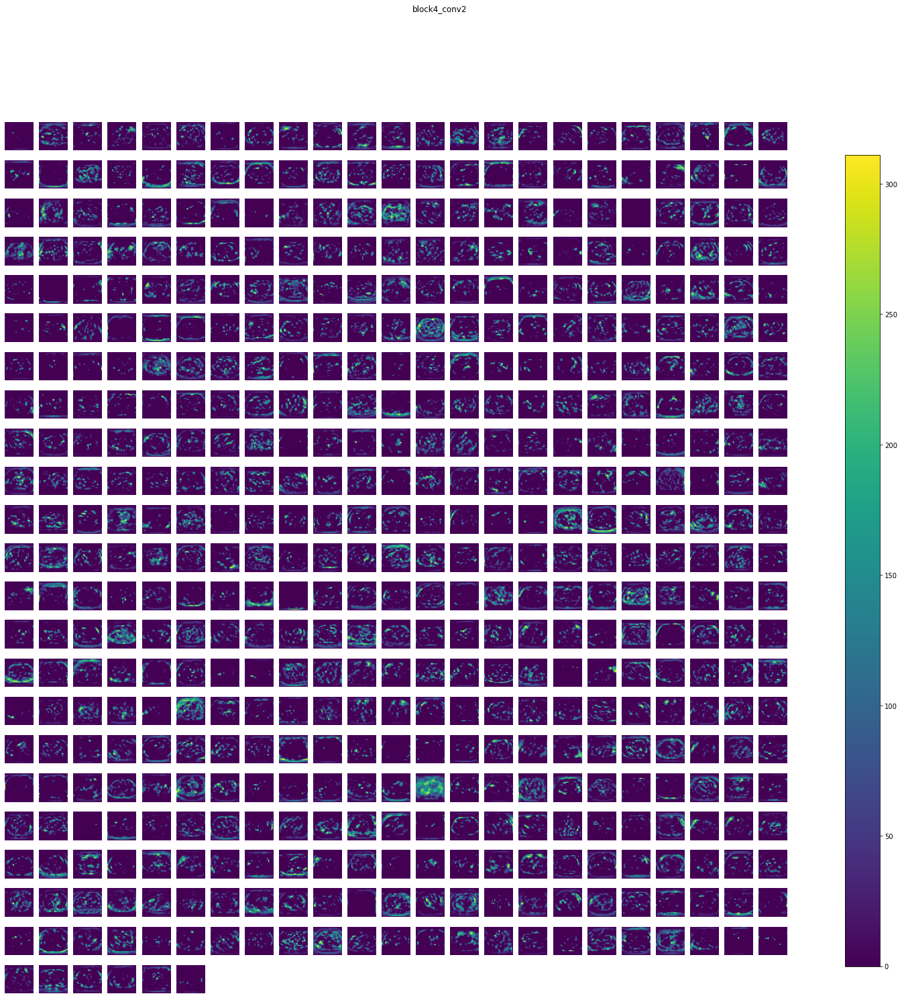

block4_conv3 (1, 37, 37, 512) 


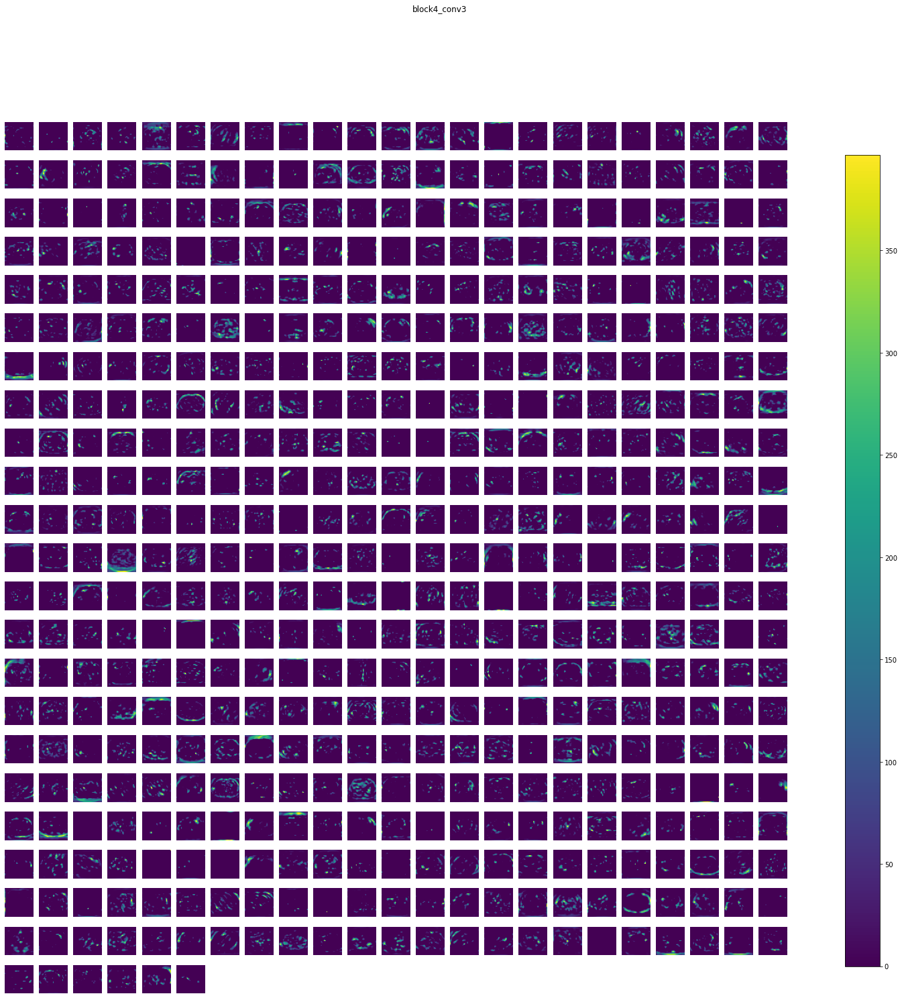

block4_pool (1, 18, 18, 512) 


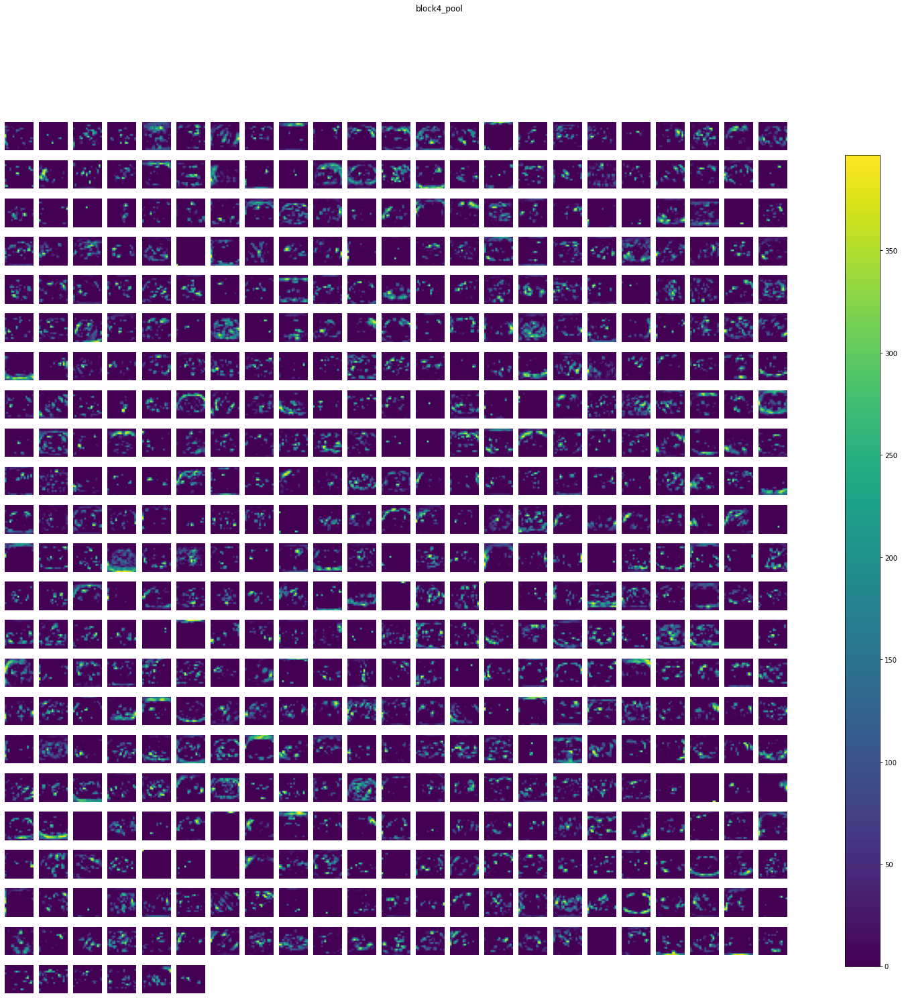

block5_conv1 (1, 18, 18, 512) 


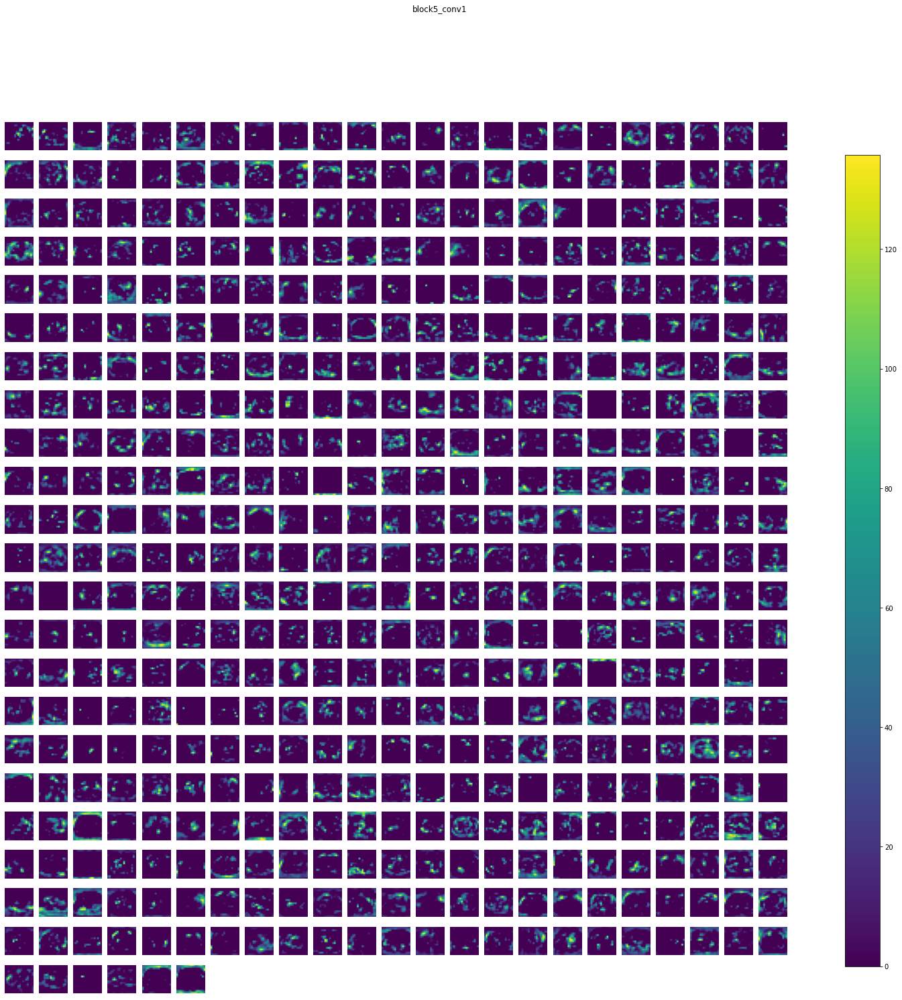

block5_conv2 (1, 18, 18, 512) 


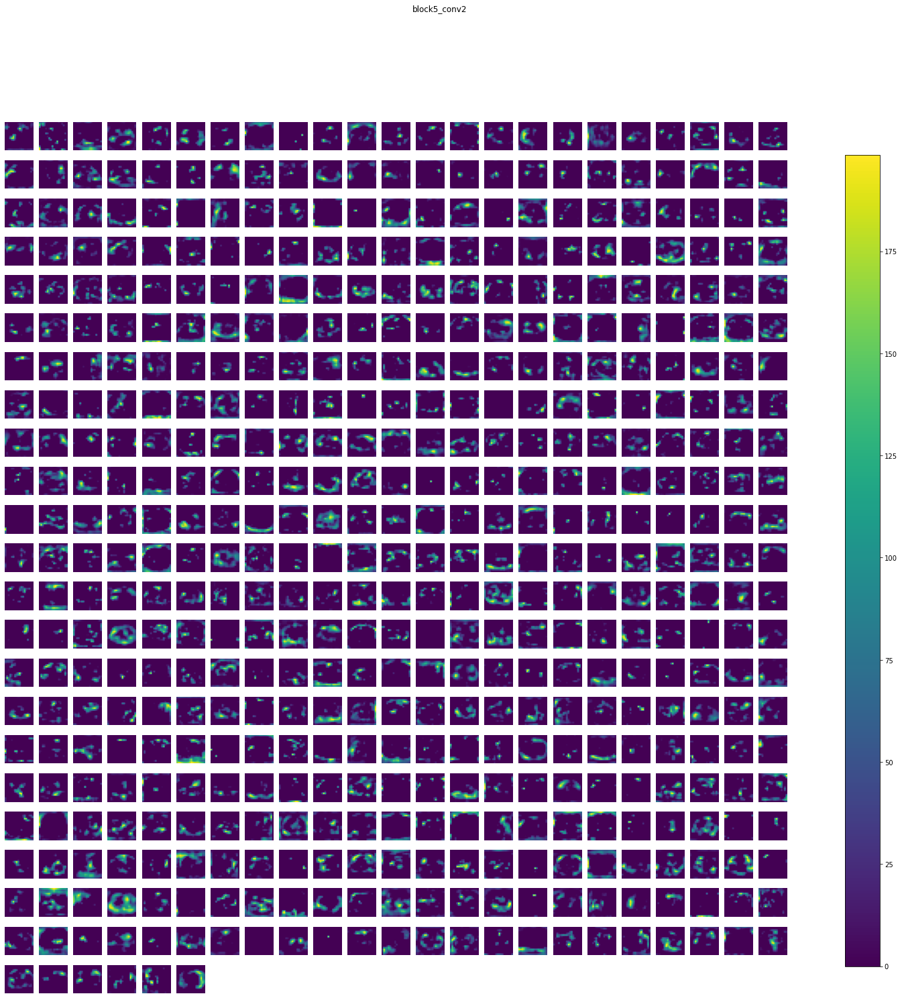

block5_conv3 (1, 18, 18, 512) 


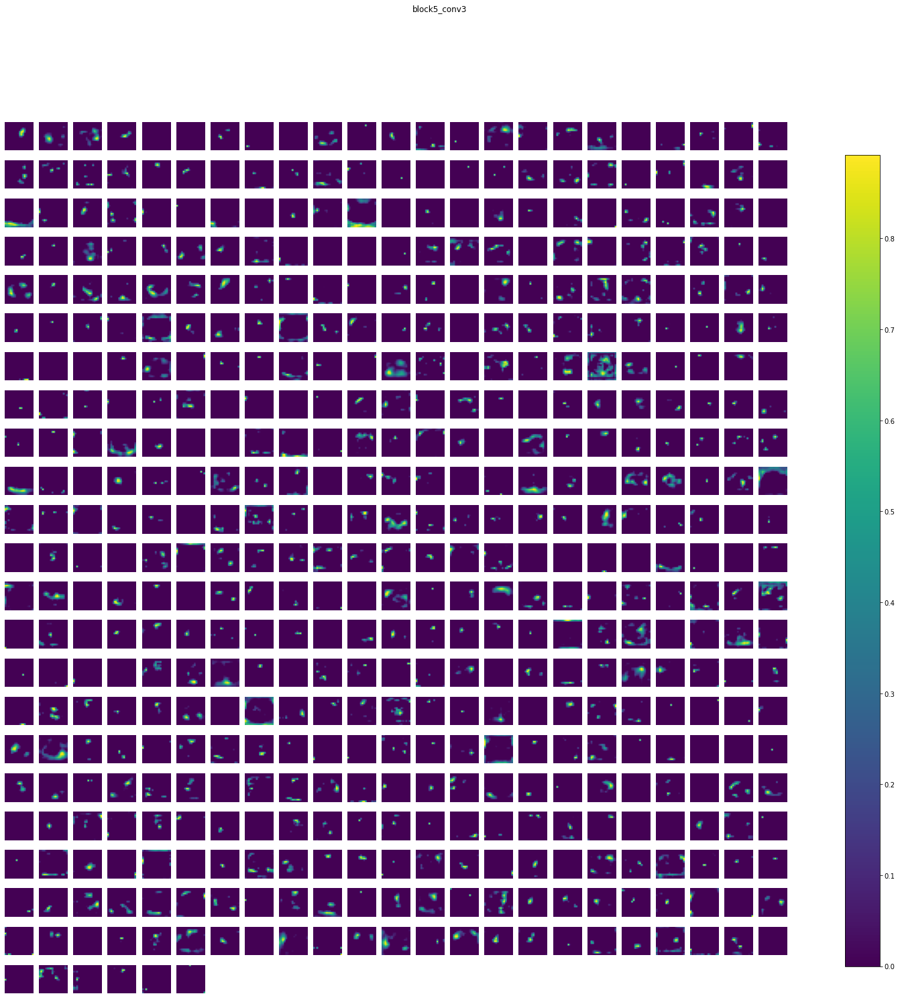

block5_pool (1, 9, 9, 512) 


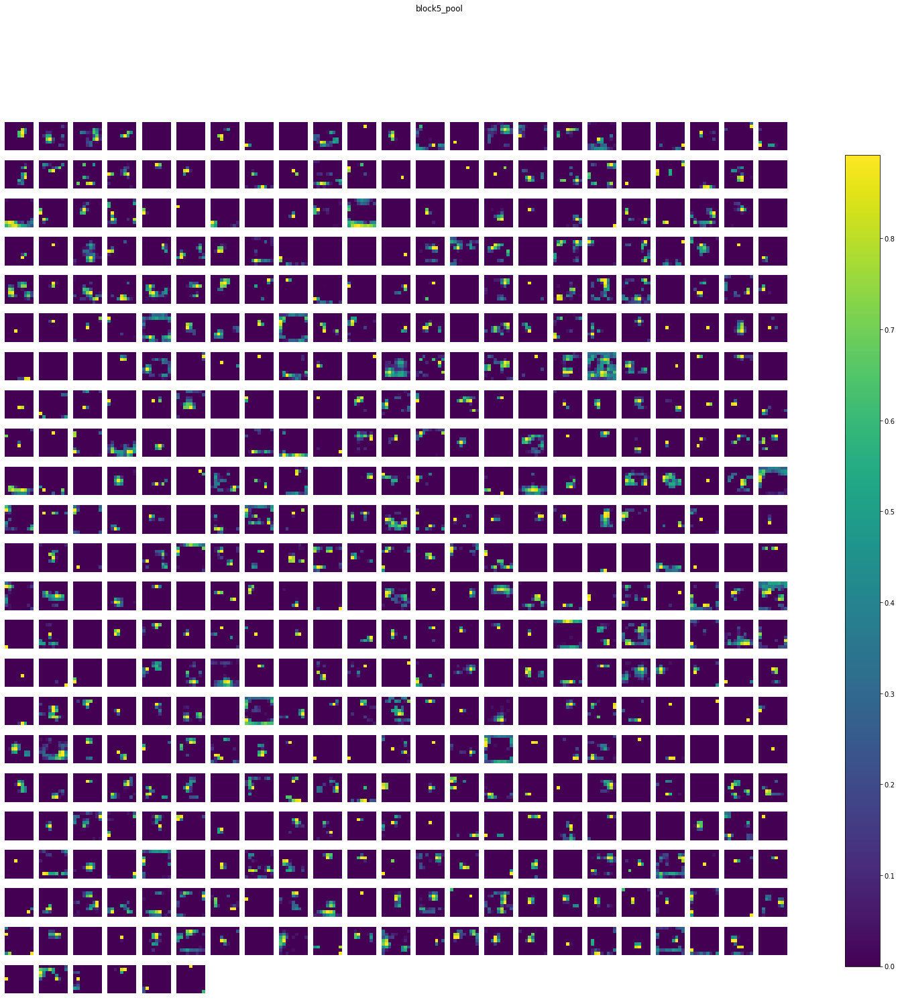

dropout (1, 9, 9, 512) 


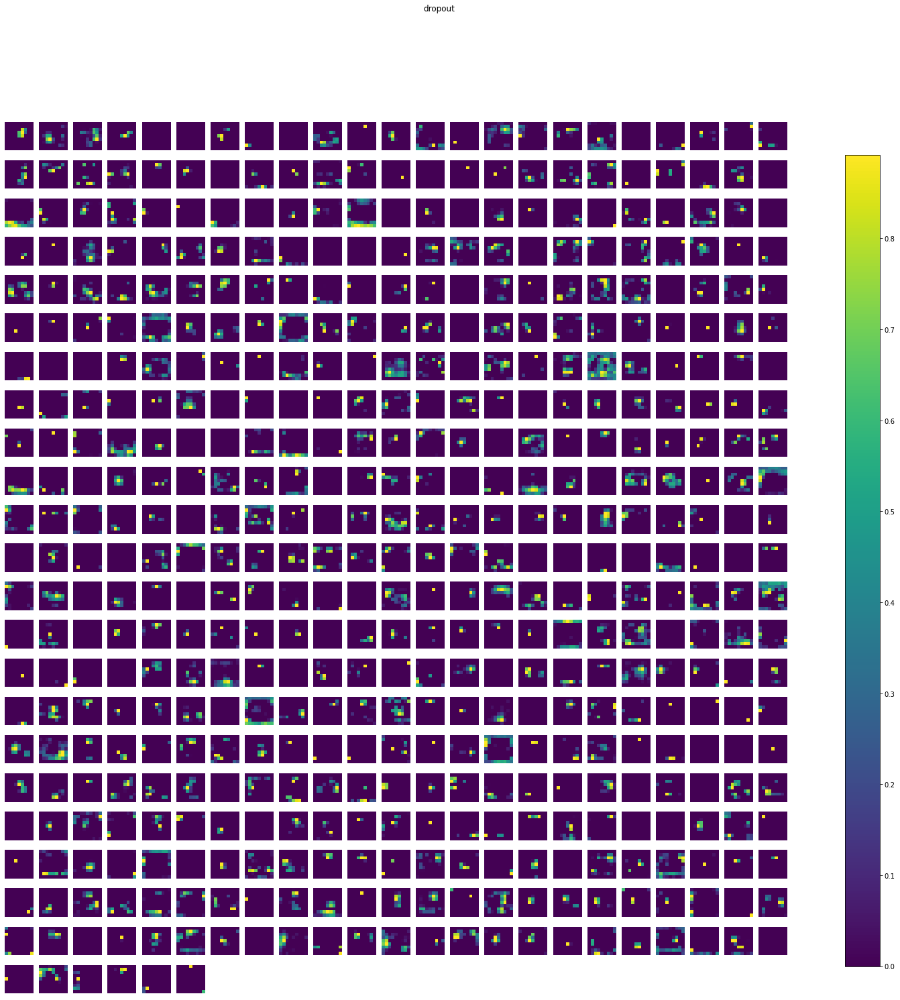

dense (1, 9, 9, 32) 


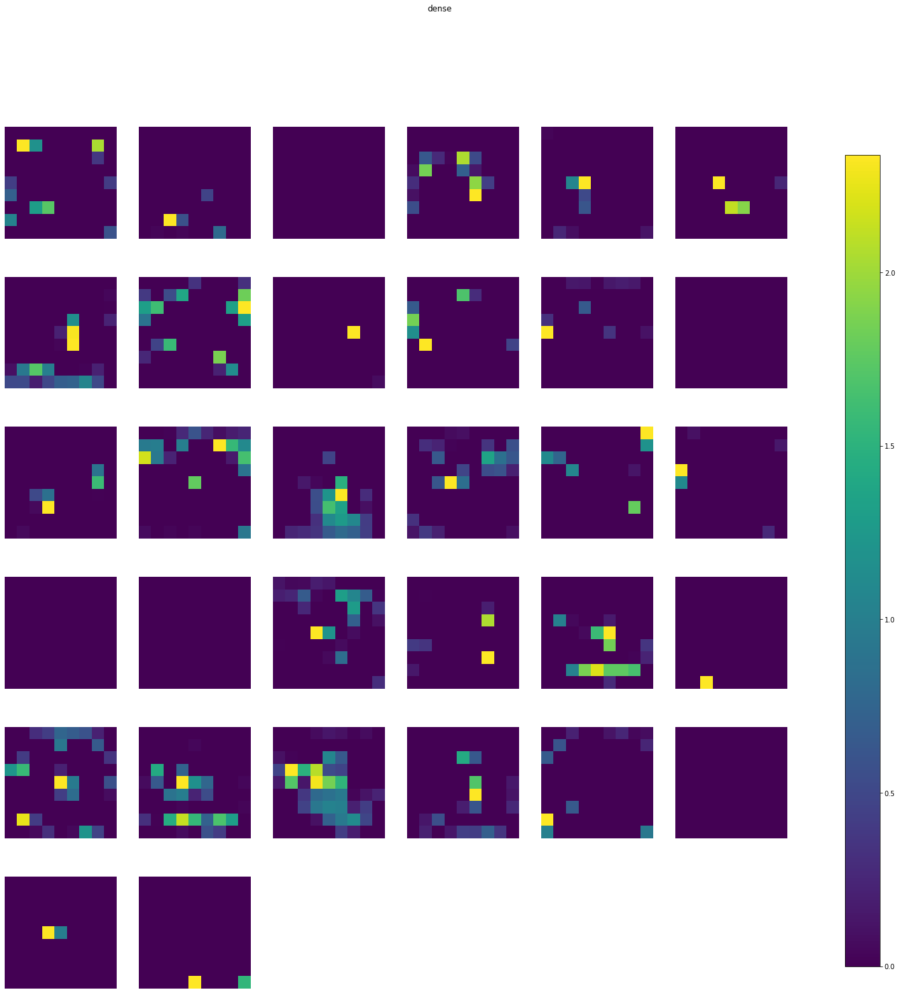

dropout_1 (1, 9, 9, 32) 


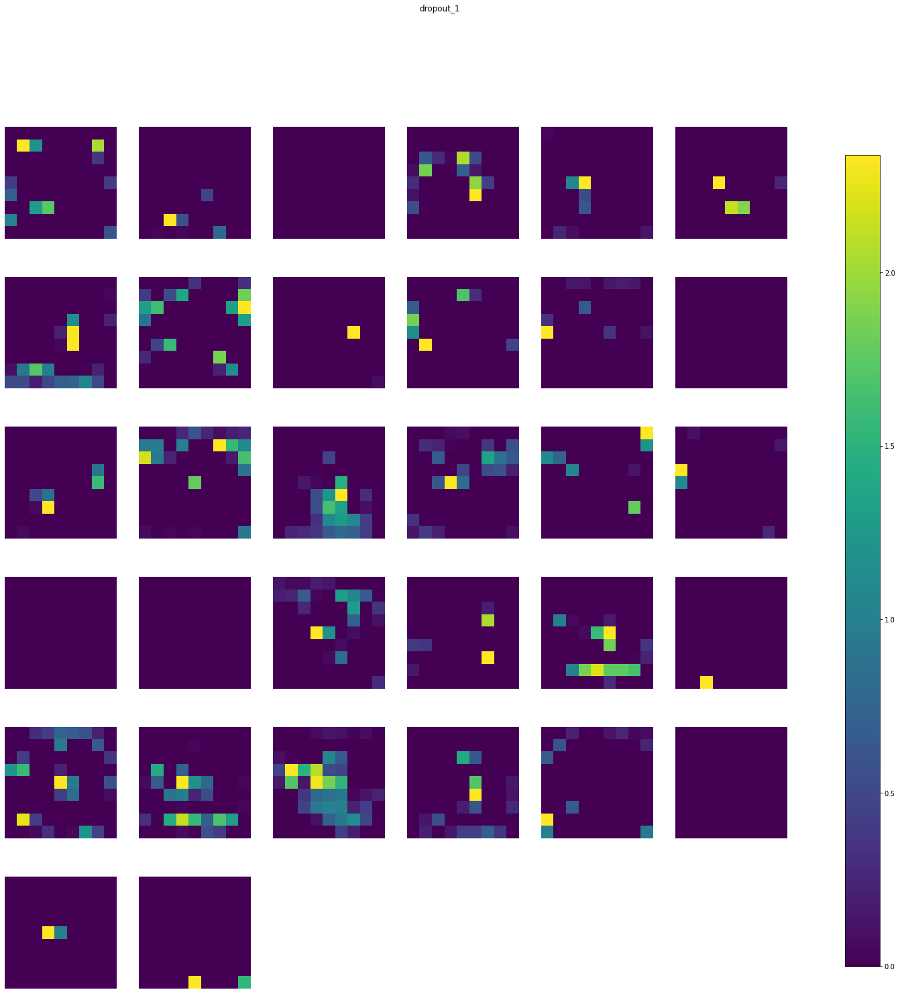

global_average_pooling2d (1, 32) 


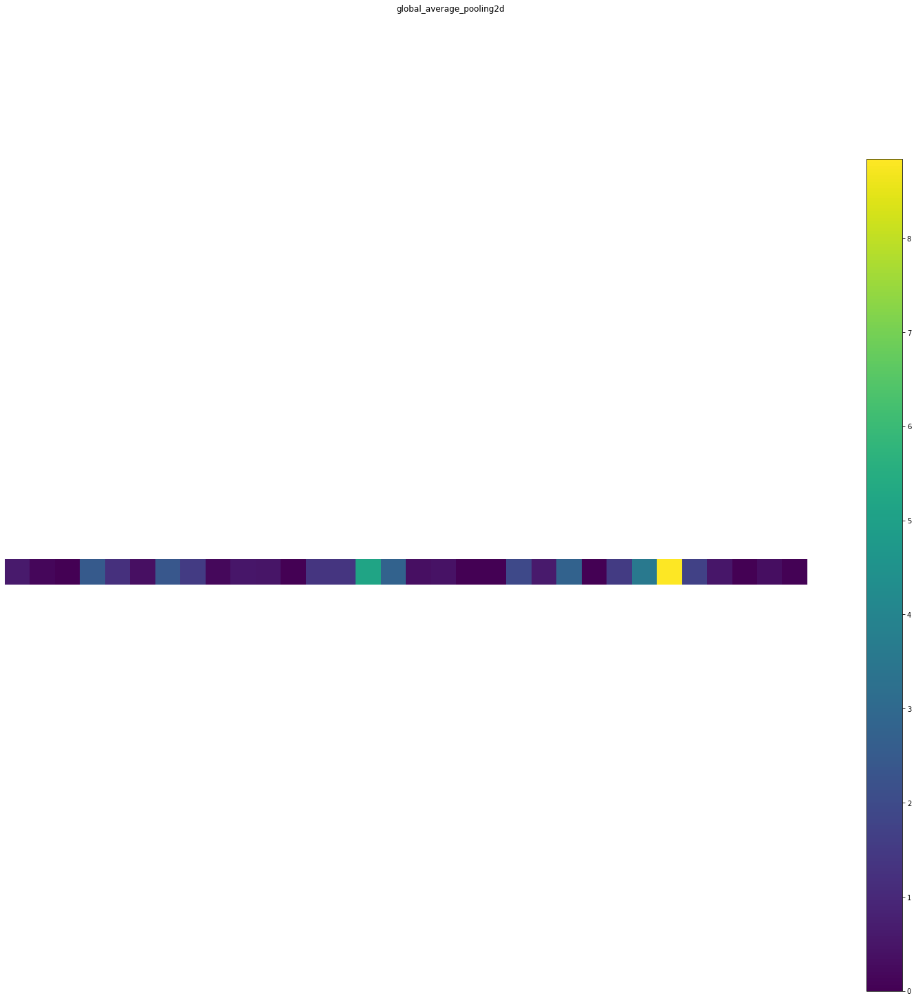

dense_1 (1, 16) 


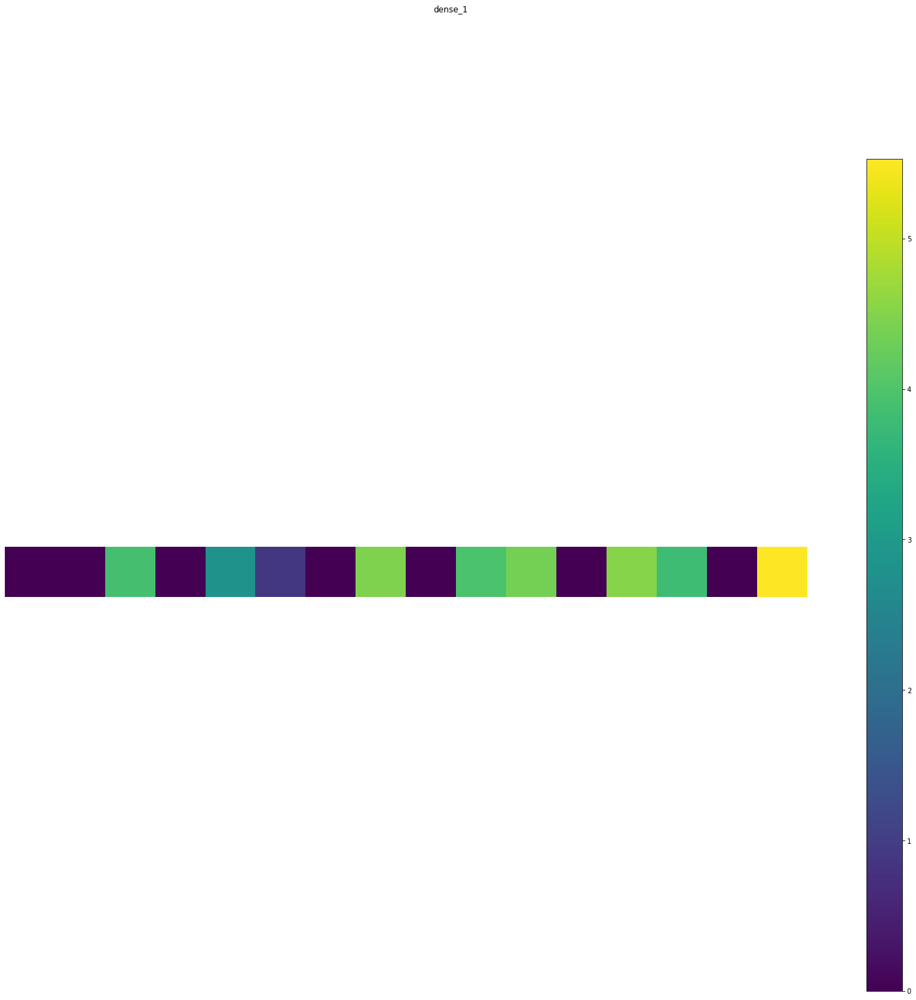

dropout_2 (1, 16) 


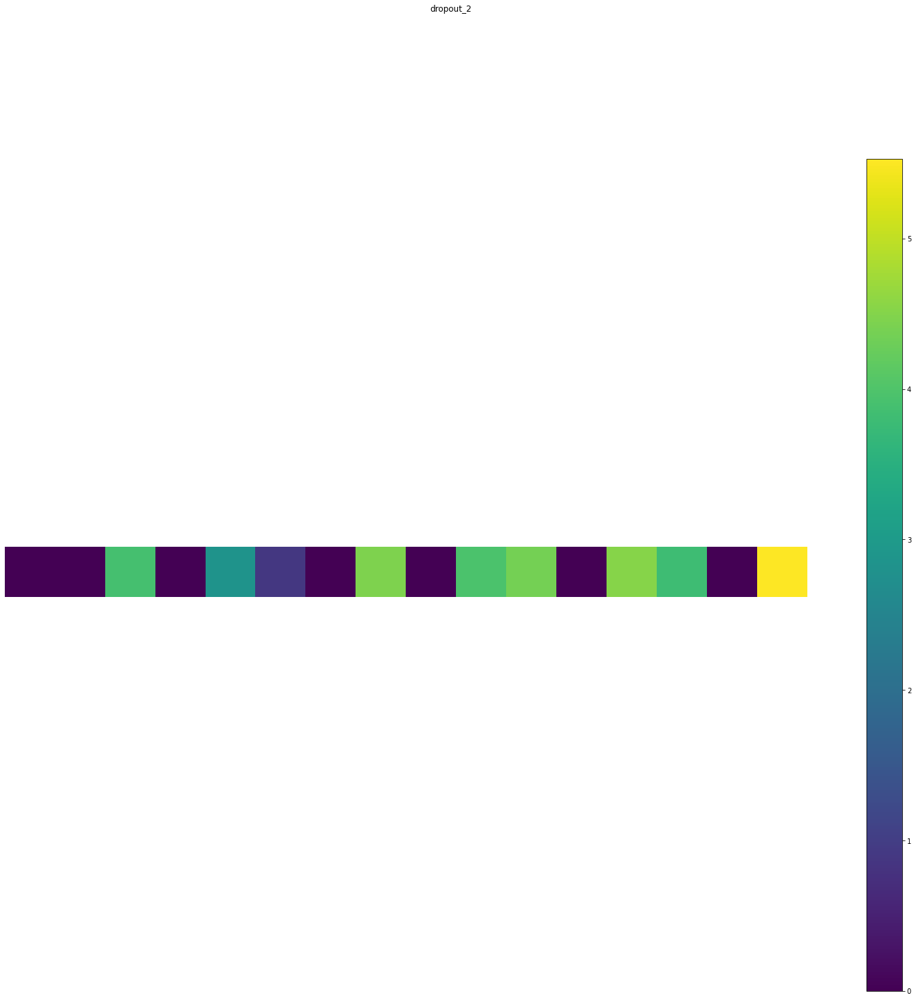

dense_2 (1, 1) 


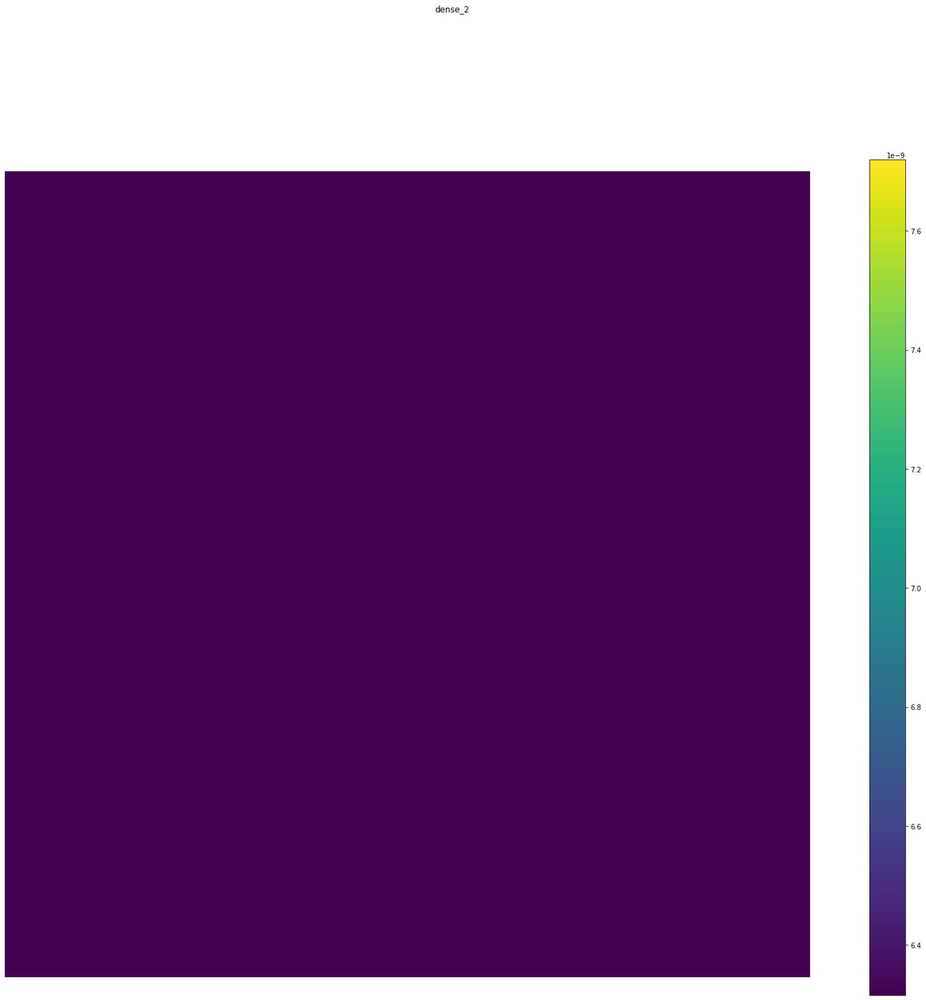

In [18]:
activations= keract.get_activations(complete_model, img_data, layer_names= None, nodes_to_evaluate= None, output_format= 'simple', auto_compile= True)
keract.display_activations(activations, save= False)

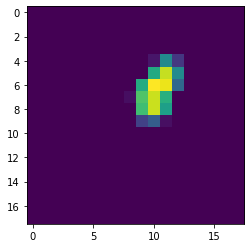

In [19]:
layer_0_conv_out = all_layer_outputs[12][0]
layer_0_conv_out.shape
plt.imshow(layer_0_conv_out[:,:,0])